# **Trabalho Final de Mineração de Dados**

by: Hellen Rosa, João Victor Porto e Laura Murayama

## bibliotecas

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score, davies_bouldin_score

## dataset

In [51]:
data = pd.read_csv('foundation_tones_complete.csv')

data.head()

,brand,line,tone,cruelty_free,brl_price,usd_price,eur_price,hex_code,rgb_red,rgb_green,rgb_blue,lab_l,lab_a,lab_b,closest_mst,tone_level
0,Adversa,Base Líquida Matte Vegana,050,True,21.0,NaN,NaN,#F5C097,245,192,151,81.482818,13.660913,27.930896,5,light
1,Adversa,Base Líquida Matte Vegana,100,True,21.0,NaN,NaN,#FDD39B,253,211,155,86.918345,7.313724,33.237453,5,light
2,Adversa,Base Líquida Matte Vegana,150,True,21.0,NaN,NaN,#F2C991,242,201,145,83.282688,7.118945,33.407593,5,light
3,Adversa,Base Líquida Matte Vegana,200,True,21.0,NaN,NaN,#F9C685,249,198,133,83.032374,10.225558,39.378735,5,light
4,Adversa,Base Líquida Matte Vegana,250,True,21.0,NaN,NaN,#F2C27A,242,194,122,81.219197,8.490120,42.523206,5,light


In [52]:
# transformar o 'cruelty_free' de booleano pra inteiro
data['cruelty_free'] = data['cruelty_free'].astype(int)
# mapear as palavras 'light' e 'dark' para números 0 e 1 na coluna 'tone_level'
data['tone_level'] = data['tone_level'].replace({'light': 0, 'dark': 1})
data.head()

,brand,line,tone,cruelty_free,brl_price,usd_price,eur_price,hex_code,rgb_red,rgb_green,rgb_blue,lab_l,lab_a,lab_b,closest_mst,tone_level
0,Adversa,Base Líquida Matte Vegana,050,1,21.0,NaN,NaN,#F5C097,245,192,151,81.482818,13.660913,27.930896,5,0
1,Adversa,Base Líquida Matte Vegana,100,1,21.0,NaN,NaN,#FDD39B,253,211,155,86.918345,7.313724,33.237453,5,0
2,Adversa,Base Líquida Matte Vegana,150,1,21.0,NaN,NaN,#F2C991,242,201,145,83.282688,7.118945,33.407593,5,0
3,Adversa,Base Líquida Matte Vegana,200,1,21.0,NaN,NaN,#F9C685,249,198,133,83.032374,10.225558,39.378735,5,0
4,Adversa,Base Líquida Matte Vegana,250,1,21.0,NaN,NaN,#F2C27A,242,194,122,81.219197,8.490120,42.523206,5,0


## Padronizar

In [53]:
# variáveis quantitativas e escolhidas para a análise de cluste'
quantitative_data = data[['cruelty_free','brl_price', 'rgb_red', 'rgb_green','rgb_blue', 'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level']]

# padronizar os dados
scaler = StandardScaler()
scaled_data = scaler.fit_transform(quantitative_data)

## Algoritmos de clusterização

### Cluster hierarquico

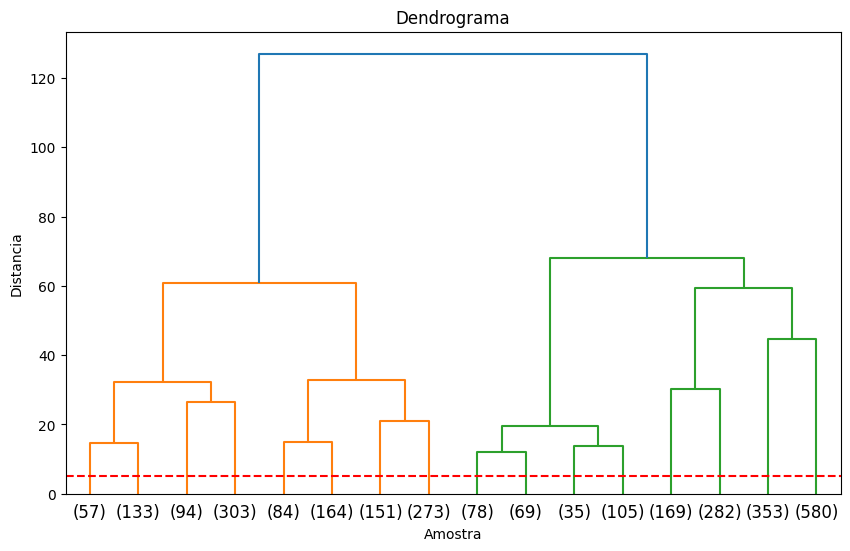

In [54]:
# calcular a matriz de linkage
linkage_matrix = linkage(scaled_data, method='ward', metric='euclidean')

# plotar o dendrograma
plt.figure(figsize=(10, 6))
dendrogram(linkage_matrix, truncate_mode='level', p=3)
plt.title('Dendrograma')
plt.xlabel('Amostra')
plt.ylabel('Distancia')
plt.axhline(y=5, color='r', linestyle='--')
plt.show()

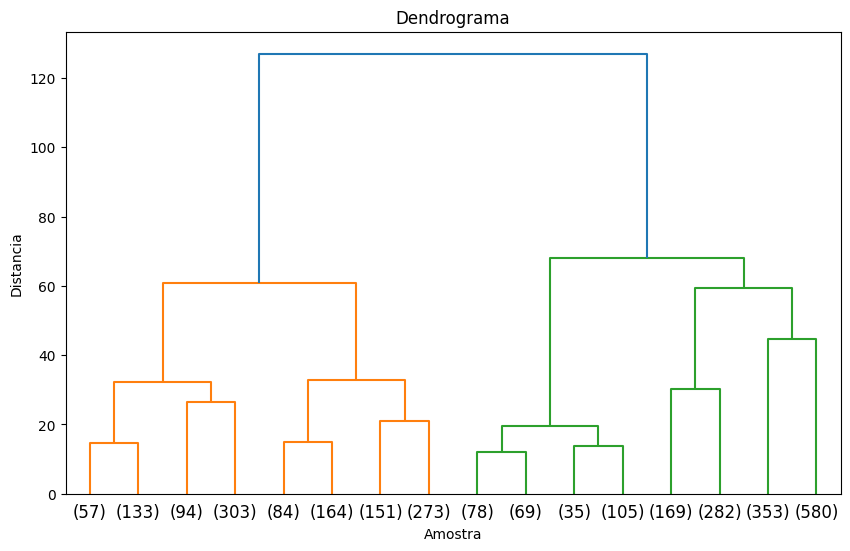

In [55]:
# plotar o dendrograma com a linha para os clusters
plt.figure(figsize=(10, 6))
dendrogram(linkage_matrix, truncate_mode='level', p=3)
plt.title('Dendrograma')
plt.xlabel('Amostra')
plt.ylabel('Distancia')
plt.show()

In [56]:
# com base no dendrograma, escolher o número de clusters
chosen_num_clusters = 3

# realizar o clustering hierárquico com o número escolhido de clusters
from scipy.cluster.hierarchy import fcluster
clusters_hierarquico = fcluster(linkage_matrix, chosen_num_clusters, criterion='maxclust')

In [57]:
# adicionar a coluna de grupos ao DataFrame original
data['Cluster Hierarquico'] = clusters_hierarquico

# salvar o DataFrame com a marcação dos grupos
data.to_excel('cluster_hierarquicos.xlsx', index=False)

# análise descritiva: média e quantidade de registros por grupo
grouped_summary = data.groupby('Cluster Hierarquico')[quantitative_data.columns].agg(['mean', 'count'])
print(grouped_summary)

                    cruelty_free         brl_price           rgb_red         
                            mean count        mean count        mean count   
Cluster Hierarquico                                                          
1                       0.533757  1259  173.139976  1259  229.491660  1259  \
2                       1.000000   287  113.206167   287  100.665505   287   
3                       0.674133  1384  150.093259  1384  178.718931  1384   

                      rgb_green          rgb_blue            lab_l         
                           mean count        mean count       mean count   
Cluster Hierarquico                                                        
1                    188.143765  1259  152.213662  1259  79.059139  1259  \
2                     57.191638   287   37.515679   287  28.920127   287   
3                    122.504335  1384   81.464595  1384  56.146637  1384   

                         lab_a            lab_b        
                  

#### Métricas

In [58]:
# calcule o coeficiente de silhueta
silhouette_avg = silhouette_score(scaled_data, clusters_hierarquico)
print(f"Coeficiente de Silhueta: {silhouette_avg}")

Coeficiente de Silhueta: 0.22500706885694063


In [59]:
# calcule o Índice Davies-Bouldin
dbi = davies_bouldin_score(scaled_data, clusters_hierarquico)
print(f"Índice Davies-Bouldin: {dbi}")

Índice Davies-Bouldin: 1.3129489359589577


### K-means

In [60]:
# encontrar o número ideal de clusters usando o método Elbow
inertia_values = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_data)
    inertia_values.append(kmeans.inertia_)

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages

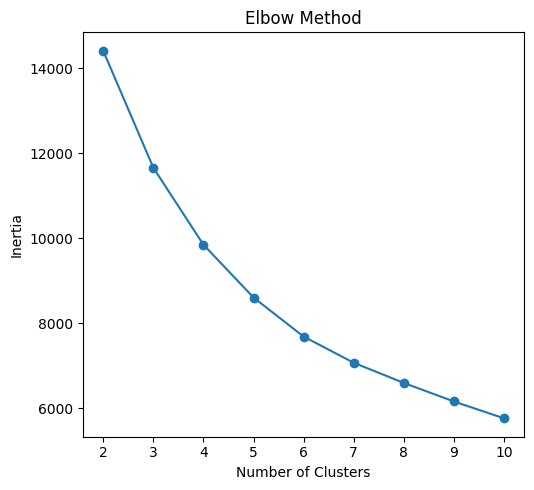

In [61]:
# plotar o gráfico Elbow para ajudar a escolher o número de clusters
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(range(2, 11), inertia_values, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')

plt.tight_layout()
plt.show()

In [62]:
# escolher o número de clusters com base na análise dos gráficos acima
chosen_num_clusters = 3

# realizar a clusterização com o número escolhido de clusters
kmeans = KMeans(n_clusters=chosen_num_clusters, random_state=42)
clusters_kmeans = kmeans.fit_predict(scaled_data)

/Users/hellenrosa/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [63]:
# adicionar a coluna de grupos ao DataFrame original
data['Kmeans'] = clusters_kmeans

# salvar o DataFrame com a marcação dos grupos
data.to_excel('cluster_kmeans.xlsx', index=False)

# análise descritiva: média e quantidade de registros por grupo
grouped_summary = data.groupby('Kmeans')[quantitative_data.columns].agg(['mean', 'count'])
print(grouped_summary)


       cruelty_free         brl_price           rgb_red         rgb_green   
               mean count        mean count        mean count        mean   
Kmeans                                                                      
0          0.604167  1104  168.326703  1104  230.312500  1104  191.378623  \
1          0.640133  1206  153.940763  1206  197.152570  1206  140.066335   
2          0.730645   620  139.866500   620  117.962903   620   68.759677   

                rgb_blue            lab_l            lab_a            lab_b   
       count        mean count       mean count       mean count       mean   
Kmeans                                                                        
0       1104  158.203804  1104  80.039882  1104   9.331759  1104  22.032407  \
1       1206   95.081260  1206  62.896464  1206  16.713279  1206  32.553732   
2        620   41.654839   620  34.395666   620  18.469750   620  24.871068   

              
       count  
Kmeans        
0       1104  
1 

#### Métricas

In [64]:
# coeficiente de silhueta
silhouette_avg = silhouette_score(scaled_data, clusters_kmeans)
print(f"Coeficiente de Silhueta: {silhouette_avg}")

# indice Davies-Bouldin
dbi = davies_bouldin_score(scaled_data, clusters_kmeans)
print(f"Índice Davies-Bouldin: {dbi}")

# inércia do modelo KMeans
inertia = kmeans.inertia_
print(f"Inércia do KMeans: {inertia}")

Coeficiente de Silhueta: 0.24774037440137395
Índice Davies-Bouldin: 1.3625105084722515
Inércia do KMeans: 11662.58971019477


### DBScan

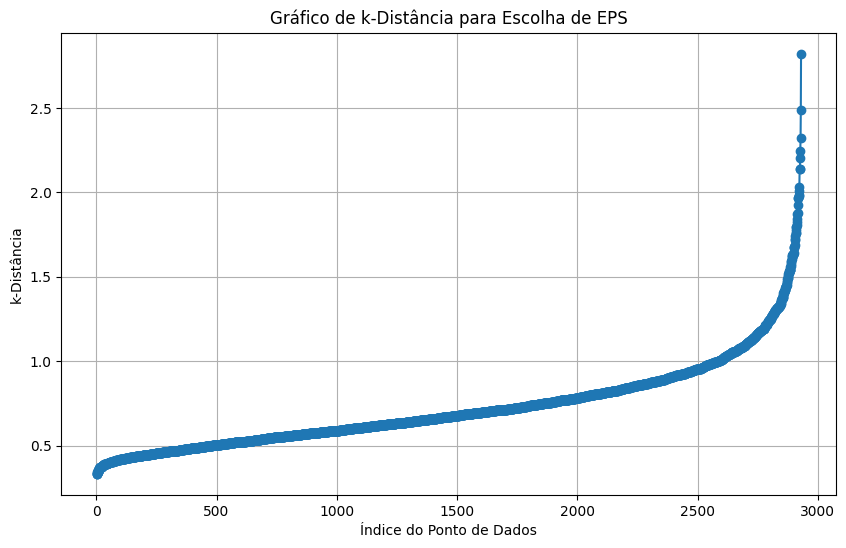

In [65]:
# calcule as k-distâncias
k = 12  # Defina o número de vizinhos mais próximos (ajuste conforme necessário)
nbrs = NearestNeighbors(n_neighbors=k).fit(scaled_data)  # Use seus dados padronizados
distances, _ = nbrs.kneighbors(scaled_data)

# ordene as k-distâncias em ordem decrescente
k_distances = np.sort(distances[:, -1])

# plote o gráfico de k-distância
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(k_distances) + 1), k_distances, marker='o')
plt.title('Gráfico de k-Distância para Escolha de EPS')
plt.xlabel('Índice do Ponto de Dados')
plt.ylabel('k-Distância')
plt.grid(True)
#plt.ylim(0, 2) 

# Exiba o gráfico
plt.show()

In [45]:
# realizar a clusterização com DBSCAN
dbscan = DBSCAN(eps=0.8, min_samples=6)
clusters_dbscan = dbscan.fit_predict(scaled_data)

In [46]:
# adicionar a coluna de grupos ao DataFrame original
data['DBScan'] = clusters_dbscan

# salvar o DataFrame com a marcação dos grupos
data.to_excel('cluster_dbscan.xlsx', index=False)


# análise descritiva: média e quantidade de registros por grupo
grouped_summary = data.groupby('DBScan')[quantitative_data.columns].agg(['mean', 'count'])
print(grouped_summary)

       cruelty_free         brl_price           rgb_red         rgb_green   
               mean count        mean count        mean count        mean   
DBScan                                                                      
-1         0.556075   214  174.527897   214  157.079439   214  107.841121  \
 0         1.000000  1745  120.257169  1745  193.787393  1745  144.813181   
 1         0.000000   869  222.057664   869  202.820483   869  155.162255   
 2         1.000000    13   65.846923    13  149.692308    13   68.923077   
 3         1.000000     7  301.571429     7  236.285714     7  193.000000   
 4         0.000000    11   42.616364    11  227.090909    11  185.272727   
 5         0.000000    11   40.573636    11  112.000000    11   64.909091   
 6         0.000000    13   42.660769    13  176.461538    13  111.615385   
 7         0.000000     8  463.420000     8  227.625000     8  195.000000   
 8         0.000000     8  458.490000     8  234.625000     8  211.250000   

#### Métricas

In [47]:
# coeficiente de silhueta
silhouette_avg = silhouette_score(scaled_data, clusters_dbscan)
print(f"Coeficiente de Silhueta: {silhouette_avg}")

# indice Davies-Bouldin
dbi = davies_bouldin_score(scaled_data, clusters_dbscan)
print(f"Índice Davies-Bouldin: {dbi}")

# inércia do modelo KMeans
inertia = kmeans.inertia_
print(f"Inércia do KMeans: {inertia}")

Coeficiente de Silhueta: -0.16482510124747526
Índice Davies-Bouldin: 1.6433249650282187
Inércia do KMeans: 12769.50318871757


## Avaliar resultados

### Pairplot

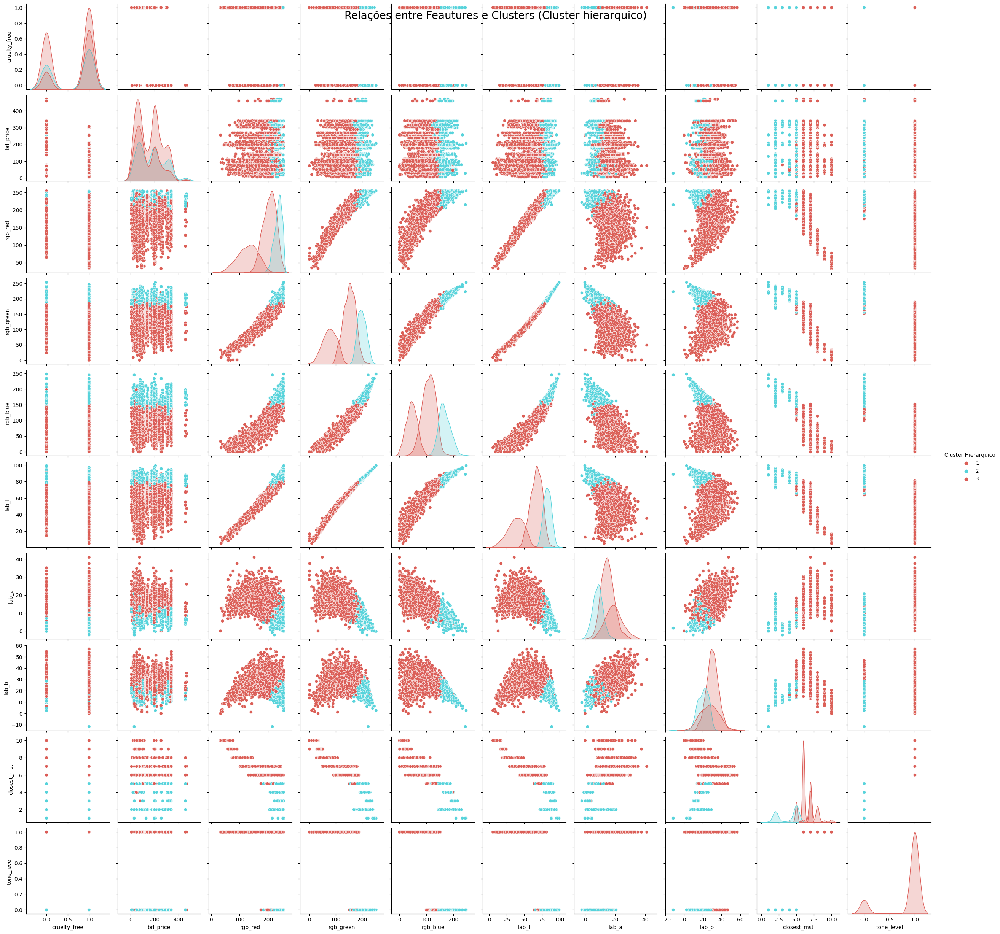

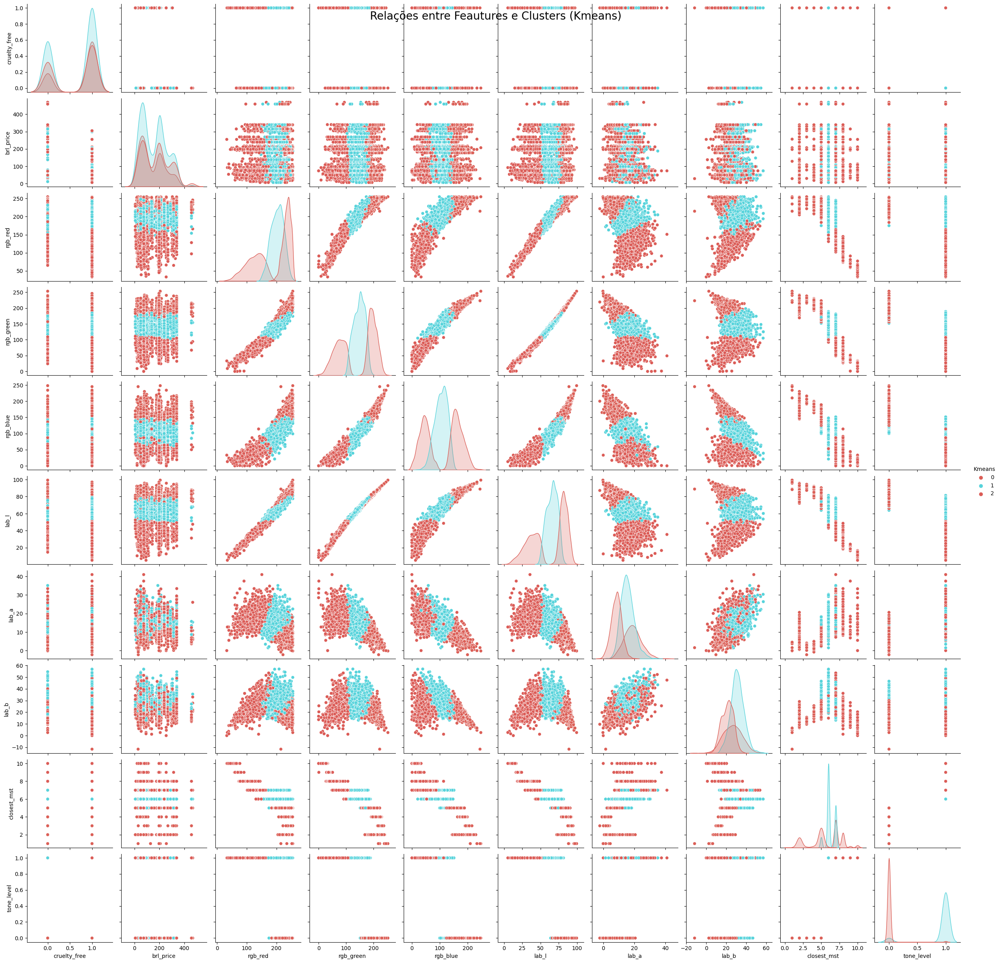

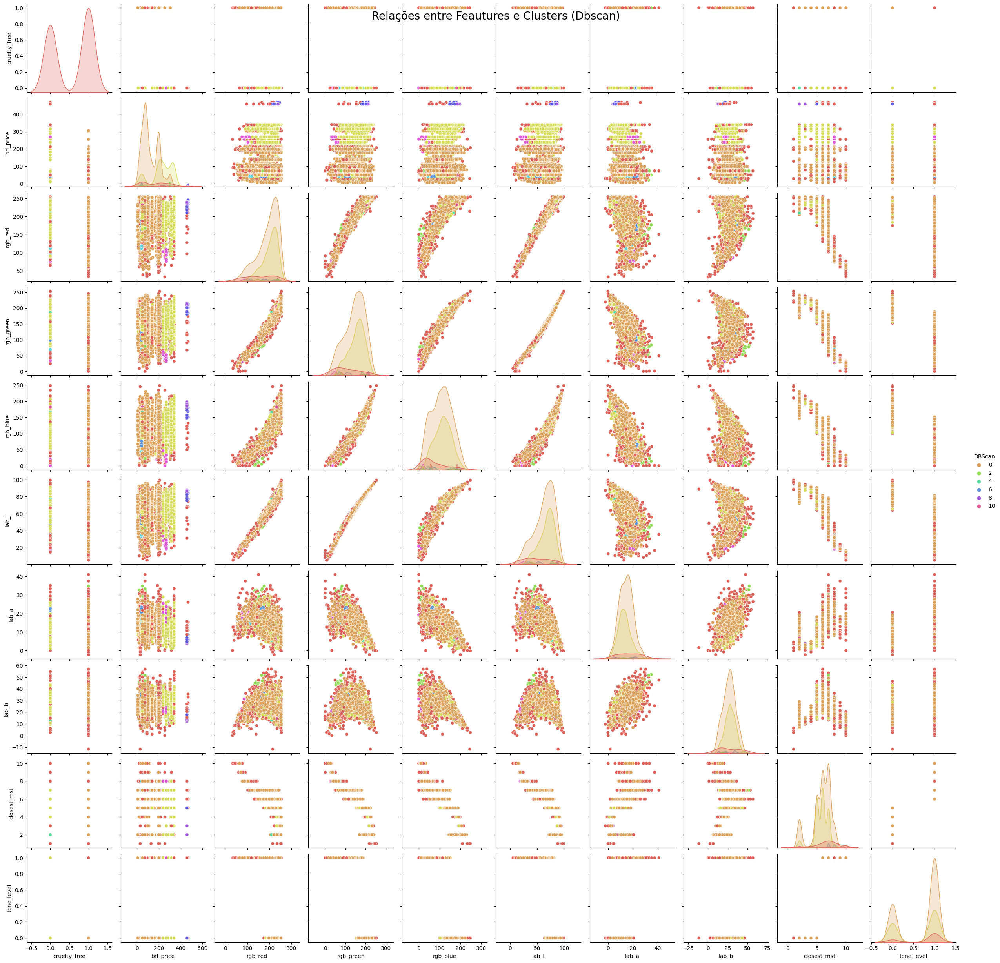

In [48]:
cluster_data = data[['cruelty_free', 'brl_price', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b',
                     'closest_mst', 'tone_level', 'Cluster Hierarquico', 'Kmeans', 'DBScan']]

# gera pairplot para analisar as relações entre as feautures e clusters (para cada algoritmo de clusterização)
algorithms = ['Cluster Hierarquico', 'Kmeans', 'DBScan']
for algorithm in algorithms:
    sns.pairplot(cluster_data, hue=algorithm, palette='hls', diag_kind='kde', vars=['cruelty_free', 'brl_price', 
                                                                                   'rgb_red', 'rgb_green', 'rgb_blue', 
                                                                                   'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level'])
    plt.suptitle(f'Relações entre Feautures e Clusters ({algorithm.capitalize()})', fontsize=20)
    plt.show()

### Scatterplot

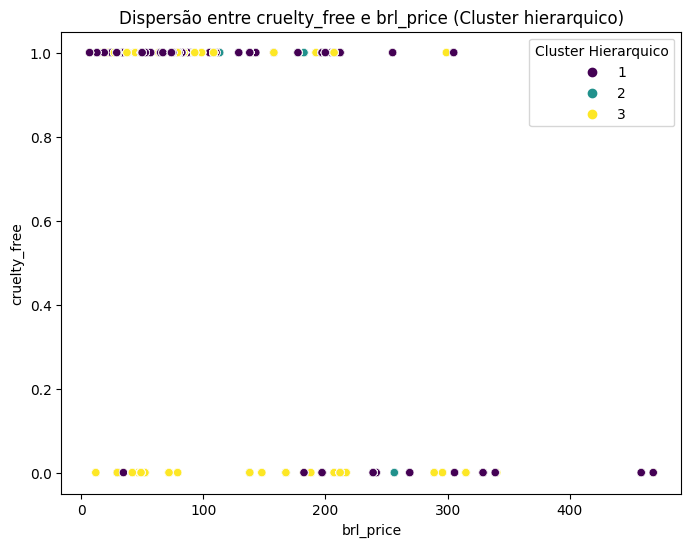

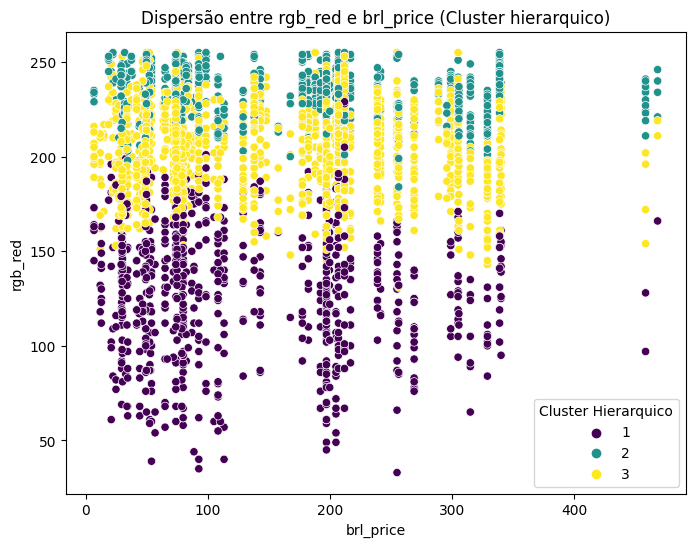

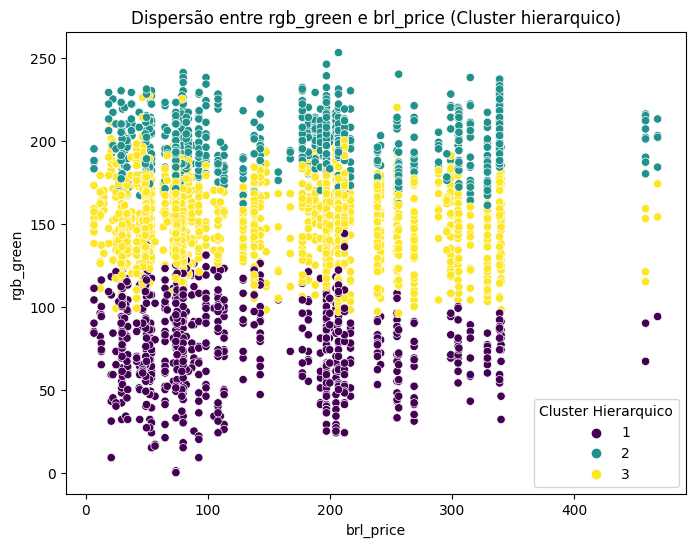

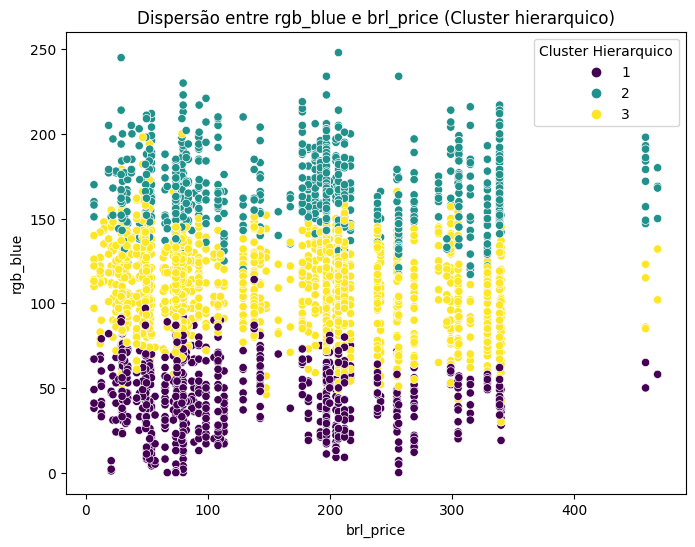

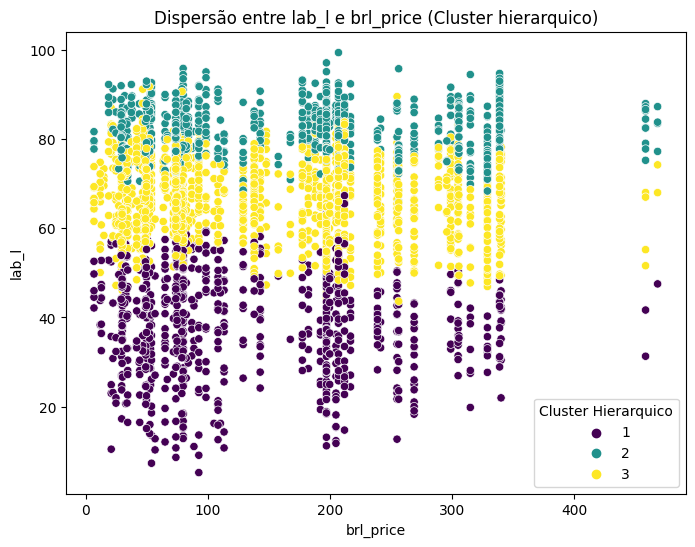

...

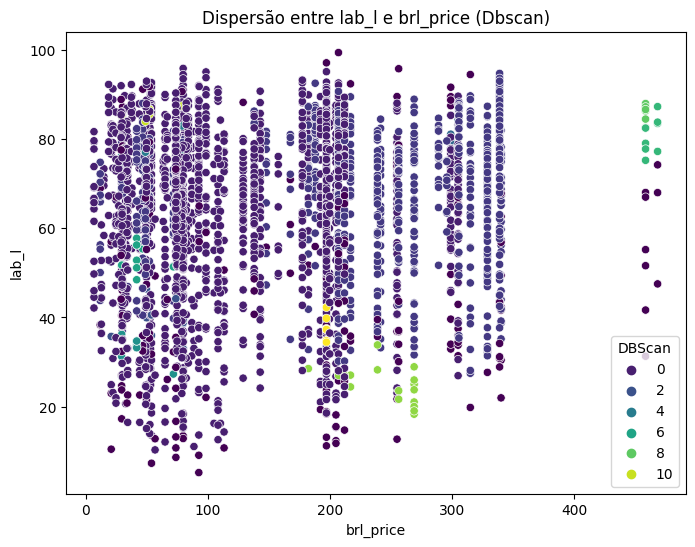

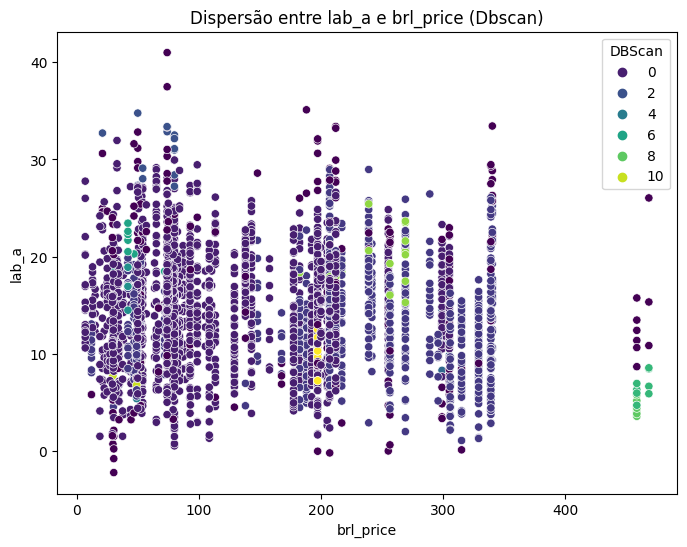

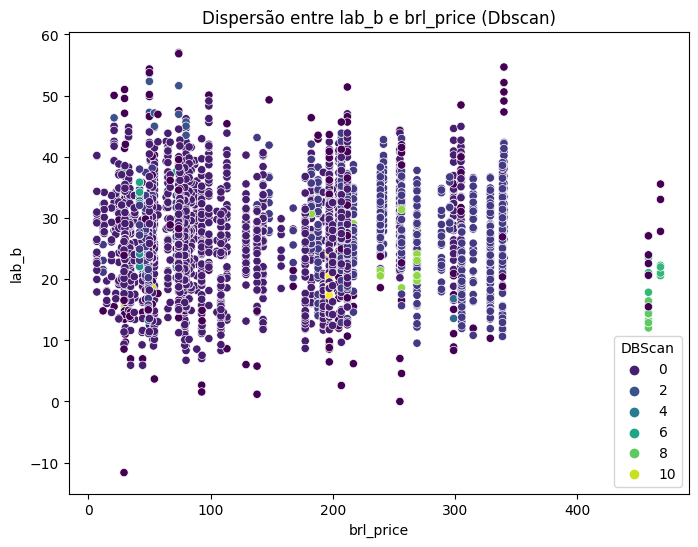

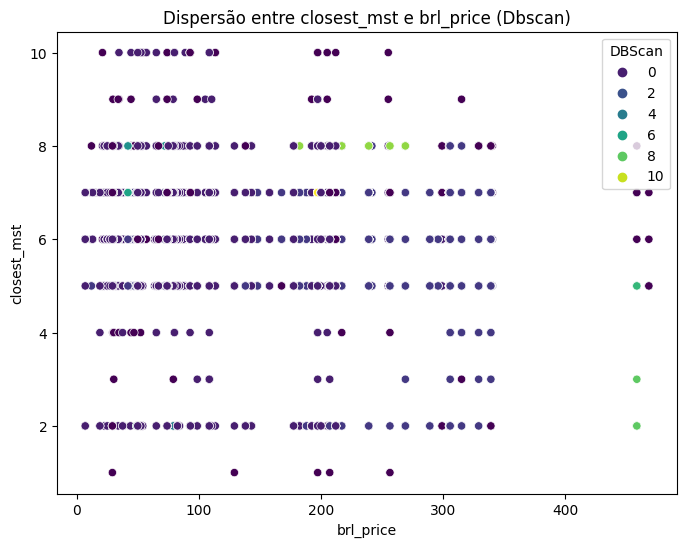

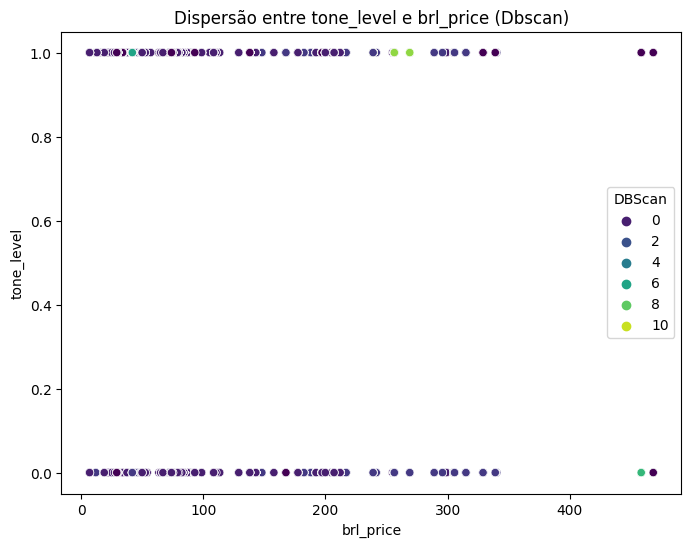

In [49]:
# scatterplot separado para cada algoritmo de clusterização
algorithms = ['Cluster Hierarquico', 'Kmeans', 'DBScan']
scatter_columns = ['cruelty_free', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level']

for algorithm in algorithms:
    for col in scatter_columns:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=cluster_data, x='brl_price', y=col, hue=algorithm, palette='viridis')
        plt.title(f'Dispersão entre {col} e brl_price ({algorithm.capitalize()})')
        plt.xlabel('brl_price')
        plt.ylabel(col)
        plt.legend(title=algorithm)
        plt.show()

### Interativo com informações dos dados qualitativos

In [50]:
import plotly.express as px

cluster_data = data[['brand', 'line', 'tone','cruelty_free', 'brl_price', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b',
                     'closest_mst', 'tone_level', 'Cluster Hierarquico', 'Kmeans', 'DBScan']]

# scatterplot interativo separado para cada algoritmo de clusterização
algorithms = ['Cluster Hierarquico', 'Kmeans', 'DBScan']
scatter_columns = ['cruelty_free', 'rgb_red', 'rgb_green', 'rgb_blue', 'lab_l', 'lab_a', 'lab_b', 'closest_mst', 'tone_level']

for algorithm in algorithms:
    for col in scatter_columns:
        fig = px.scatter(cluster_data, x='brl_price', y=col, color=algorithm,
                         title=f'Dispersão entre {col} e brl_price ({algorithm.capitalize()})',
                         labels={'brl_price': 'brl_price', col: col}, 
                         hover_data=['brand', 'line', 'tone'], 
                         template='plotly', opacity=0.7)
        fig.update_traces(marker=dict(size=8))
        fig.show()